[<font color='steelblue'>1. - __Imports__</font>](#one-bullet) <br>
[<font color='steelblue'>2. - __Metadata Analysis__</font>](#two-bullet) <br>
[<font color='steelblue'>3. - __Data Split__</font>](#three-bullet) <br>
[<font color='steelblue'>4. - __Black and White Analysis__</font>](#four-bullet) <br>
[<font color='steelblue'>5. - __PreProcess for Outlier Removal__</font>](#five-bullet) <br>
[<font color='steelblue'>6. - __Outlier Removal__</font>](#six-bullet) <br>
[<font color='steelblue'>7. - __Cropped Images Datasets__</font>](#seven-bullet) <br>

Group 07
|Name | Number |
|----|----|
|Fábio dos Santos| 20240678|
|Joana Rodrigues| 20240603|
|Mara Simões| 20240326|
|Matilde Street| 20240523|
|Rafael Borges| 20240497|

<hr>
<a class="anchor" id="one-bullet"> 
<d style="color:white;">

## 1. Imports
</a> 
</d>   

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import shutil
from pathlib import Path
from zipfile import ZipFile
import pickle

import os
from PIL import Image
import math
import plotly.express as px
import shutil

import tensorflow as tf
from tensorflow import add
from tensorflow.keras import layers, models
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Flatten, Dense
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.metrics import CategoricalAccuracy, AUC, SparseCategoricalAccuracy
from keras.layers import LeakyReLU
from keras.utils import to_categorical
from keras.metrics import F1Score

import hdbscan
from tensorflow.keras.applications import VGG16
from transformers import CLIPProcessor, TFCLIPModel
from sklearn.ensemble import IsolationForest
from sklearn.metrics.pairwise import cosine_distances
from sklearn.utils import class_weight
from sklearn.preprocessing import LabelEncoder

from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
import uuid
from collections import Counter
from PIL import Image

### Choose your path

In [2]:
# # If on Google Colab, uncomment this to mount the Google Drive and set the root path
# from google.colab import drive
# drive.mount('/content/drive')

# root = Path('/content/drive/MyDrive')

# # If on local machine, comment the lines above and uncomment the line below
# Path if on Local Machine:
root = Path('.')

<a class="anchor" id="two-bullet"> 
<d style="color:white;">

## 2. Metadata Analysis
</a> 
</d>
The goal with this section is to better understand the data we are dealing with to best know the challenges and the approaches we should take to deal with them.

In [3]:
path = 'data/metadata.csv'
df = pd.read_csv(path)

df.head()

,rare_species_id,eol_content_id,eol_page_id,kingdom,phylum,family,file_path
0,75fd91cb-2881-41cd-88e6-de451e8b60e2,12853737,449393,animalia,mollusca,unionidae,mollusca_unionidae/12853737_449393_eol-full-si...
1,28c508bc-63ff-4e60-9c8f-1934367e1528,20969394,793083,animalia,chordata,geoemydidae,chordata_geoemydidae/20969394_793083_eol-full-...
2,00372441-588c-4af8-9665-29bee20822c0,28895411,319982,animalia,chordata,cryptobranchidae,chordata_cryptobranchidae/28895411_319982_eol-...
3,29cc6040-6af2-49ee-86ec-ab7d89793828,29658536,45510188,animalia,chordata,turdidae,chordata_turdidae/29658536_45510188_eol-full-s...
4,94004bff-3a33-4758-8125-bf72e6e57eab,21252576,7250886,animalia,chordata,indriidae,chordata_indriidae/21252576_7250886_eol-full-s...


### Family Distribution

Understanding the distribution of the family variable is important to determine the number of output classes for our model and potential class imbalance issues.

In [4]:
len(df['family'].unique())

202

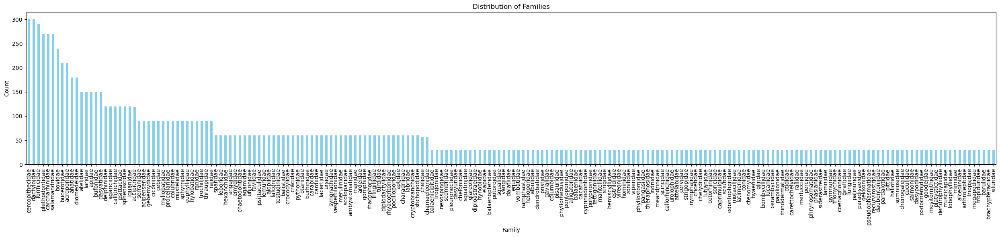

In [5]:
plt.figure(figsize=(25, 6))
df['family'].value_counts().plot(kind='bar', color='skyblue')
plt.title('Distribution of Families')
plt.xlabel('Family')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [6]:
df_counts = df.groupby(["phylum", "family"]).size().reset_index(name="count")

fig = px.sunburst(df_counts, path=["phylum", "family"], values="count")
fig.update_layout(title={"text": "Family distribution per phylum", "x": 0.5, "xanchor": "center", "font": {"color": "black"}})
fig.show()

We can conclude that the dataset is dominated by the Chordata phylum and is imbalanced across families. In the future, techniques such as data augmentation or class weighting could be used to compensate for this issue.

For the next step, we extract metadata from all images in the dataset. The code goes through each subfolder in the main data directory and for every image, it returns:

- **Width** and **Height** of the image
- **Aspect Ratio** (width divided by height)
- **Color Mode** (e.g., RGB, grayscale)

In [7]:
data_directory = Path("data")

img_meta = {}
for class_folder in data_directory.iterdir():
    
    if class_folder.is_dir():
        folder_content = class_folder.glob("*")
        images = [img for img in folder_content if img.is_file()]

        for img_path in images:
            with Image.open(img_path) as img:
                    width, height = img.size
                    aspect_ratio = round(width / height, 2)
                    mode = img.mode

                    img_meta[str(img_path.name)] = {
                        'Width': width, 
                        'Height': height, 
                        'AspectRatio': aspect_ratio,
                        'Mode': mode}
    

img_meta_df = pd.DataFrame.from_dict(img_meta, orient='index').reset_index()
img_meta_df.rename(columns={'index': 'FileName'}, inplace=True)

img_meta_df.head()

c:\Users\marsi\anaconda3\envs\DM2425\Lib\site-packages\PIL\Image.py:3368: DecompressionBombWarning:

Image size (115600000 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



,FileName,Width,Height,AspectRatio,Mode
0,20647903_1065369_eol-full-size-copy.jpg,1536,2048,0.75,RGB
1,20647904_1065369_eol-full-size-copy.jpg,1536,2048,0.75,RGB
2,20647909_1065369_eol-full-size-copy.jpg,1536,2048,0.75,RGB
3,20647915_1065369_eol-full-size-copy.jpg,2048,1154,1.77,RGB
4,21834153_1065290_eol-full-size-copy.jpg,2048,1417,1.45,RGB


Text(0.5, 0, 'Mode')

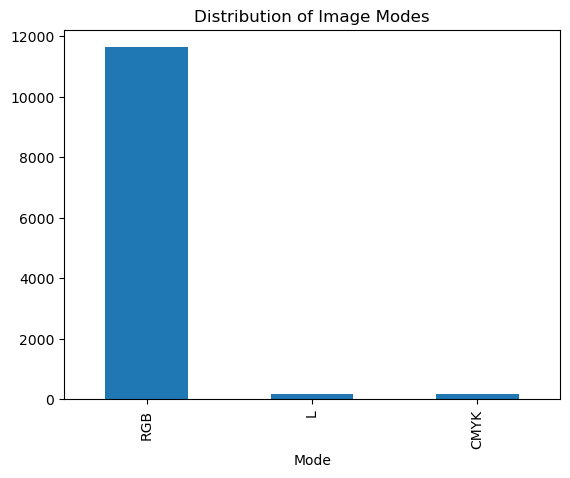

In [8]:
img_meta_df['Mode'].value_counts().plot(kind='bar')
plt.title('Distribution of Image Modes')
plt.xlabel('Mode')

We can observe from the bar plot above that RGB is the most common image mode. There are some images in L and CMYK but these represent a small minority of the dataset.

- **RGB**: Red, Green, Blue (color images)
- **L**: Luminance (grayscale)
- **CMYK**: Cyan, Magenta, Yellow, Black (used for printing)

We need to convert all images to RGB format during preprocessing. 

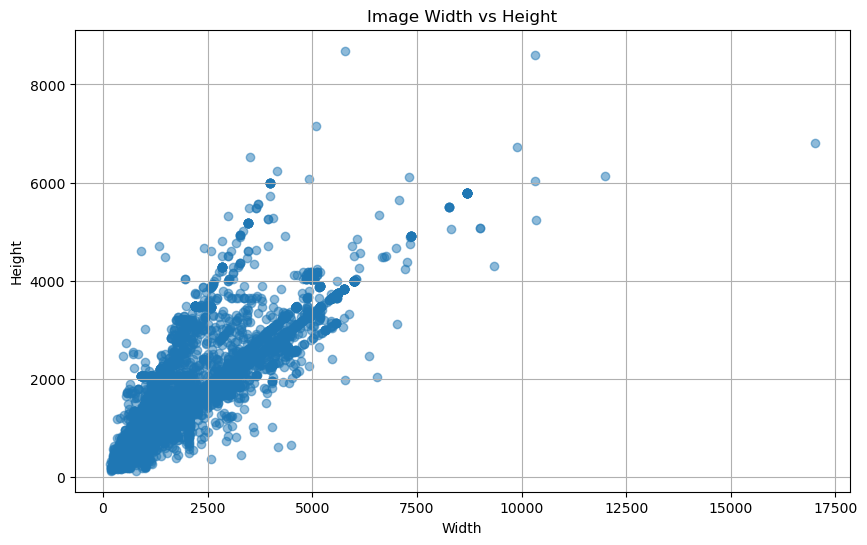

In [9]:
plt.figure(figsize=(10, 6))
plt.scatter(img_meta_df['Width'], img_meta_df['Height'], alpha=0.5)
plt.title('Image Width vs Height')
plt.xlabel('Width')
plt.ylabel('Height')
# plt.xlim(0, 3000)
# plt.ylim(0, 3000)
plt.grid()
plt.show()

The visualization above helps us understand the variability in image sizes.
We can see that:

- Most images fall within a width range of 500–4000 pixels and a height range of 500–4500 pixels.
- There is a positive correlation between width and height.
- A few images appear as outliers. These could cause errors in training if not handled properly.

Based on this information, it is important to resize all images to a standard size or remove outlier.

<a class="anchor" id="three-bullet"> 
<d style="color:white;">

## 3. Data Split
</a> 
</d>   

### Separate Sample
This was used in the beggining of our project to ensure the codes were working before dealing with the whole dataset. This helped us in terms of efficiency as it obviously helped the program run faster.  

(To run this we neeed to make sure that we have the following:
- folder named 'data' with the unziped content of the data provided by the teacher. 
- empty folder named 'data_sample' where the data is going sample, copied and splited).  

In [10]:
# all_data_directory = root / 'data' 
# dest_data_sample_folder = root / "data_sample" 

# # Create the destination folder if it doesn't exist
# if dest_data_sample_folder.exists():
#     print(f"Removing existing folder: {dest_data_sample_folder}")
#     shutil.rmtree(dest_data_sample_folder)  # Remove the folder if it exists
#     dest_data_sample_folder.mkdir(parents=True)  # Create the folder
#     print(f"Empty data folder created at: {dest_data_sample_folder}")

# # Creating the destination directories for train, test, and val.
# for split in ["train", "test", "val"]:
#     (dest_data_sample_folder / split).mkdir(parents=True, exist_ok=True)

# # Iterate over each class folder in the main directory.
# for class_folder in all_data_directory.iterdir():
#     if class_folder.is_dir():

#         # Retrieve the folder content from that class.
#         folder_content = class_folder.glob("*")

#         # List images in the class folder.
#         images = [img for img in folder_content if img.is_file()]
        
#         # Take the first 5 images.
#         selected_images = images[:5]
        
#         train_imgs = selected_images[:3] ## 3 images for training
#         test_imgs = selected_images[3:4] ## 1 image for testing
#         val_imgs = selected_images[4:] ## 1 image for validation
        
#         # Copy images to each split
#         for img in train_imgs:
#             dest_folder = dest_data_sample_folder / "train" / class_folder.name
#             dest_folder.mkdir(parents=True, exist_ok=True)
#             shutil.copy(img, dest_folder / img.name)
            
#         for img in val_imgs:
#             dest_folder = dest_data_sample_folder / "val" / class_folder.name
#             dest_folder.mkdir(parents=True, exist_ok=True)
#             shutil.copy(img, dest_folder / img.name)
            
#         for img in test_imgs:
#             dest_folder = dest_data_sample_folder / "test" / class_folder.name
#             dest_folder.mkdir(parents=True, exist_ok=True)
#             shutil.copy(img, dest_folder / img.name)

### Separate Whole Dataset
We split the dataset into three subsets: training set (60%), validation set (20%) and test set (20%) and created 3 folders each representing one of those subsets.

In [11]:
all_data_directory = root / 'data' 
dest_root = root / "data_split"

train_pct = 0.6
val_pct = 0.2

for split in ["train", "test", "val"]:
    (dest_root / split).mkdir(parents=True, exist_ok=True)

for class_folder in all_data_directory.iterdir():
    if class_folder.is_dir():

        folder_content = class_folder.glob("*")

        images = [img for img in folder_content if img.is_file()]

        total_images = len(images)
        
        train_count = int(total_images * train_pct)
        val_count = int(total_images * val_pct)
        test_count = total_images - train_count - val_count
        
        train_imgs = images[:train_count]
        val_imgs = images[train_count:train_count + val_count]
        test_imgs = images[train_count + val_count:]
        
        for img in train_imgs:
            dest_folder = dest_root / "train" / class_folder.name
            dest_folder.mkdir(parents=True, exist_ok=True)
            shutil.copy(img, dest_folder / img.name)
            
        for img in val_imgs:
            dest_folder = dest_root / "val" / class_folder.name
            dest_folder.mkdir(parents=True, exist_ok=True)
            shutil.copy(img, dest_folder / img.name)
            
        for img in test_imgs:
            dest_folder = dest_root / "test" / class_folder.name
            dest_folder.mkdir(parents=True, exist_ok=True)
            shutil.copy(img, dest_folder / img.name)

Read the folders that contain the data already splitted

In [12]:
def get_image_paths_and_labels(base_path):
    base = Path(base_path)
    image_paths = list(base.rglob("*.jpg"))  
    data = {
        "filepath": [str(p) for p in image_paths],
        "label": [p.parent.name for p in image_paths]
    }
    return pd.DataFrame(data)


# Get the paths and labels for train, val, and test sets
dest_root = Path('.') / "data_split"
train_df = get_image_paths_and_labels(dest_root / 'train')
# val_df = get_image_paths_and_labels(dest_root / 'val') # used for outlier comparison
# test_df = get_image_paths_and_labels(dest_root / 'test') # used for outlier comparison

<a class="anchor" id="four-bullet"> 
<d style="color:white;">

## 4. Black and White Analysis
</a> 
</d> 
As observed before there are several images that are black and white, therefore the following code was done to see if there is a pattern between them, mostly to identify whether they are related to errors or is just random.

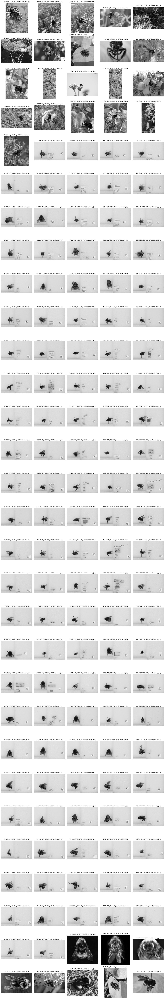

In [13]:
def plot_all_grayscale_images(folder_path):
    image_paths = [p for p in folder_path.glob("*") if p.is_file()]
    total_images = len(image_paths)

    if total_images == 0:
        print("Nenhuma imagem encontrada.")
        return

    cols = 5
    rows = math.ceil(total_images / cols)
    plt.figure(figsize=(cols * 3, rows * 3))

    for i, path in enumerate(image_paths):
        with Image.open(path) as img:
            gray_img = img.convert("L")  # Convert to grayscale
            plt.subplot(rows, cols, i + 1)
            plt.imshow(gray_img, cmap='gray')
            plt.title(path.name, fontsize=8)
            plt.axis('off')

    plt.tight_layout()
    plt.show()

data_directory = Path("data")
all_data_directory = Path('.') / 'data' 
first_class_folder = next(p for p in all_data_directory.iterdir() if p.is_dir())

plot_all_grayscale_images(first_class_folder)

We can conclude that the black and white images are not related with outliers.

<a class="anchor" id="five-bullet"> 
<d style="color:white;">

## 5. PreProcess for Outlier Removal
</a> 
</d> 
This is done to the train dataset as the ouliers will only be removed from the train dataset to avoid data leakage.

The validation and the test are done only for comparison purposes to see the best outlier method created in the next section.

In [14]:
encoder = LabelEncoder()
encoder.fit(train_df["label"])

pickle.dump(encoder, open("encoder.pkl", 'wb'))

train_df["label_encoded"] = encoder.transform(train_df["label"])
# val_df["label_encoded"] = encoder.transform(val_df["label"])  # for outlier comparison
# test_df["label_encoded"] = encoder.transform(test_df["label"]) # for outlier comparison

From now on the rest of pre processing is only done to compare the outlier approaches.

In [15]:
train_paths = train_df["filepath"].values
train_labels = train_df["label_encoded"].values

# val_paths = tf.constant(val_df["filepath"].values) 
# val_labels = tf.constant(val_df["label_encoded"].values) 

# test_paths = tf.constant(test_df["filepath"].values) 
# test_labels = tf.constant(test_df["label_encoded"].values) 

train_dataset = tf.data.Dataset.from_tensor_slices((train_paths, train_labels))
# val_dataset = tf.data.Dataset.from_tensor_slices((val_paths, val_labels)) 
# test_dataset = tf.data.Dataset.from_tensor_slices((test_paths, test_labels)) 

In [16]:
# def resize_with_padding(image, target_height=224, target_width=224):
#     shape = tf.shape(image)[:2] 
#     height, width = tf.cast(shape[0], tf.float32), tf.cast(shape[1], tf.float32)

#     scale = tf.minimum(target_width / width, target_height / height)
#     new_height = tf.cast(height * scale, tf.int32)
#     new_width = tf.cast(width * scale, tf.int32)

#     resized_image = tf.image.resize(image, [new_height, new_width])

#     pad_height = (target_height - new_height) // 2
#     pad_width = (target_width - new_width) // 2
#     padded_image = tf.image.pad_to_bounding_box(resized_image, pad_height, pad_width, target_height, target_width)

#     return padded_image

In [17]:
# normalization_layer = tf.keras.layers.Rescaling(1./255) # 0-1 normalization

# def decode_img(img_path, label):
#     img = tf.io.read_file(img_path)
#     img = tf.image.decode_jpeg(img, channels=3)
#     img = resize_with_padding(img) 
#     img = normalization_layer(img)
#     label = tf.one_hot(label, depth=202)
#     return img, label

# train_dataset = train_dataset.map(decode_img).batch(32).prefetch(tf.data.AUTOTUNE)
# val_dataset = val_dataset.map(decode_img).batch(32).prefetch(tf.data.AUTOTUNE)
# test_dataset = test_dataset.map(decode_img).batch(32).prefetch(tf.data.AUTOTUNE)

<a class="anchor" id="six-bullet"> 
<d style="color:white;">

## 6. Outlier Removal
</a> 
</d> 

We compared three different techniques to determine the most effective method for cleaning the dataset:

1. **DBSCAN** with VGG16 features
2. **Isolation Forest** with VGG16 features
3. **CLIP-based semantic filtering**

In [18]:
def extract_features(image_paths, target_size=(224, 224)):
    model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))  
    model = Model(inputs=model.input, outputs=model.output)  

    features = []
    for img_path in image_paths:
        img = tf.io.read_file(img_path)
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, target_size)
        img = tf.keras.applications.vgg16.preprocess_input(img)  
        img = np.expand_dims(img, axis=0)  
        feature = model.predict(img)  
        features.append(feature.flatten())  
    return np.array(features)

def plot_outlier_images(images_paths, outliers_indices, num_to_show=10):
    if len(outliers_indices) == 0:
        print("No outliers to display.")
        return
    
    num_to_show = min(num_to_show, len(outliers_indices))
    plt.figure(figsize=(15, 5))
    for i, idx in enumerate(outliers_indices[:num_to_show]):
        img = tf.io.read_file(images_paths[idx])
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, (224, 224)) / 255.0  
        plt.subplot(1, num_to_show, i+1)
        plt.imshow(img)
        plt.title(f"Outlier {idx}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

In [19]:
def save_clean_images(image_paths, labels, target_root):
    """
    Saves cleaned images into class-specific folders inside the target root directory.
    """
    for img_path, label in zip(image_paths, labels):
        class_folder = os.path.join(target_root, str(label))
        os.makedirs(class_folder, exist_ok=True)
        dest_path = os.path.join(class_folder, os.path.basename(img_path))
        shutil.copy(img_path, dest_path)

    print(f"Saved {len(image_paths)} cleaned images to: {target_root}")

#### **1 - DBSCAN**

In [20]:
# def outliers_per_class_remover_dbscan(images_paths, labels, show_outliers=True, num_to_show=10):
#     cleaned_image_paths = []
#     cleaned_image_labels = []
#     total_outliers = 0

#     unique_labels = np.unique(labels)

#     for label in unique_labels:
#         class_indices = np.where(labels == label)[0]
#         class_image_paths = images_paths[class_indices]
#         n_images = len(class_image_paths)

#         if n_images <= 30:
#             cleaned_image_paths.extend(class_image_paths)
#             cleaned_image_labels.extend(labels[class_indices])
#             continue

#         class_features = extract_features(class_image_paths)

#         min_cluster_size = max(5, n_images // 10)
#         min_samples = 3
#         epsilon = 0.2

#         dbscan = hdbscan.HDBSCAN(
#             min_samples=min_samples,
#             min_cluster_size=min_cluster_size,
#             cluster_selection_epsilon=epsilon
#         )
#         cluster_labels = dbscan.fit_predict(class_features)

#         all_outliers_indices = np.where(cluster_labels == -1)[0]

#         if len(all_outliers_indices) > 0:
#             centroid = np.mean(class_features, axis=0, keepdims=True)
#             distances = cosine_distances(class_features, centroid).flatten()

#             outlier_distances = distances[all_outliers_indices]
#             sorted_indices = np.argsort(outlier_distances)[::-1] 
#             top_outliers = all_outliers_indices[sorted_indices[:10]]  
#         else:
#             top_outliers = np.array([], dtype=int)

#         non_outliers_indices = np.setdiff1d(np.arange(len(class_image_paths)), top_outliers)
#         outliers_count = len(top_outliers)
#         total_outliers += outliers_count

#         cleaned_image_paths.extend(np.array(class_image_paths)[non_outliers_indices])
#         cleaned_image_labels.extend([label] * len(non_outliers_indices))

#         print(f"Class {label} - Outliers removed: {outliers_count}")
#         if show_outliers:
#             plot_outlier_images(class_image_paths, top_outliers, num_to_show=num_to_show)

#     print(f"\nTotal outliers identified: {total_outliers}")
#     print(f"Total images after outlier removal: {len(cleaned_image_paths)}")

#     return np.array(cleaned_image_paths), np.array(cleaned_image_labels)

# cleaned_image_paths, cleaned_image_labels = outliers_per_class_remover_dbscan(train_paths, train_labels)

# print(f"Cleaned dataset contains {len(cleaned_image_paths)} images.")

In [21]:
# # Remove images saved from previous dbscan 
# shutil.rmtree("data_clean_dbscan", ignore_errors=True)

# save_clean_images(
#     cleaned_image_paths,
#     cleaned_image_labels,
#     target_root="data_clean_dbscan"
# )

#### **2 - Isolation Forest**

In [22]:
# def outliers_per_class_remover(image_paths, labels, plot_images = True, contamination=0.02):
#     cleaned_image_paths = []
#     cleaned_image_labels = []
#     total_outliers = 0 
#     unique_labels = np.unique(labels)
    
#     for label in unique_labels:
#         class_indices = np.where(labels == label)[0]
#         class_image_paths = image_paths[class_indices]
        
#         if len(class_image_paths) <= 30:
#             cleaned_image_paths.extend(class_image_paths)
#             cleaned_image_labels.extend(labels[class_indices])
#             continue
        
#         class_image_features = extract_features(class_image_paths)  
        
#         iso_forest = IsolationForest(contamination=contamination)
#         outliers = iso_forest.fit_predict(class_image_features)
        
#         outliers_count = np.sum(outliers == -1)  
#         total_outliers += outliers_count  
        
#         non_outliers_indices = np.where(outliers == 1)[0]  
#         outliers_indices = np.where(outliers == -1)[0]  
        
#         cleaned_image_paths.extend(class_image_paths[non_outliers_indices])
#         cleaned_image_labels.extend(labels[class_indices][non_outliers_indices])

#         print(f"Class {label} - Outliers removed: {outliers_count}")
#         if plot_images == True:
#             plot_outlier_images(class_image_paths, outliers_indices) 

#     print(f"Total outliers removed: {total_outliers}")
    
#     return np.array(cleaned_image_paths), np.array(cleaned_image_labels)

# cleaned_image_paths, cleaned_image_labels = outliers_per_class_remover(train_paths, train_labels, contamination=0.02)

# print(f"Cleaned dataset contains {len(cleaned_image_paths)} images.")

In [23]:
# shutil.rmtree("data_clean_vgg16", ignore_errors=True)

# save_clean_images(
#     cleaned_image_paths,
#     cleaned_image_labels,
#     target_root="data_clean_vgg16"
# )

#### **3 - CLIP**

We initially used a threshold based on the formula mean + k × standard deviation to identify outliers. However, after evaluating the results, we conclude that using a fixed threshold of 0.3 led to better performance and higher evaluation scores. Therefore, we adopted 0.3 as the optimal threshold.

All model checkpoint layers were used when initializing TFCLIPModel.

All the layers of TFCLIPModel were initialized from the model checkpoint at openai/clip-vit-base-patch32.
If your task is similar to the task the model of the checkpoint was trained on, you can already use TFCLIPModel for predictions without further training.
Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.


Class 0
Class 0 - Outliers removed: 2
Showing 2 outlier(s):


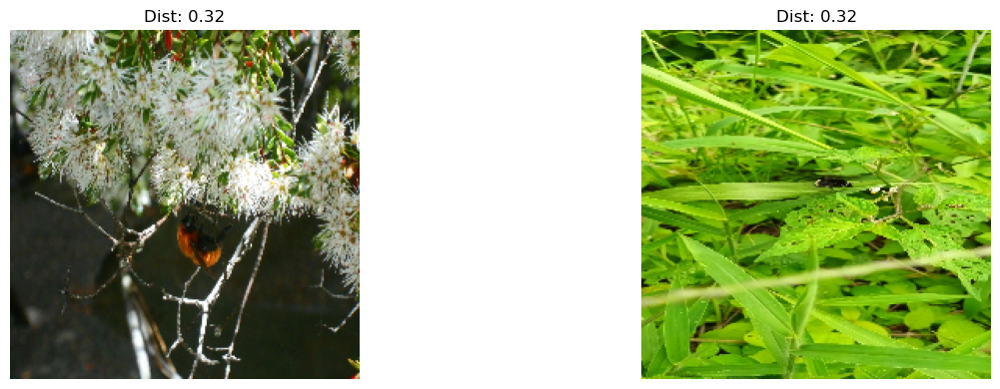


Class 1
Class 1 - Outliers removed: 0
No outliers detected for this class.

Class 2
Class 2 - Outliers removed: 1
Showing 1 outlier(s):


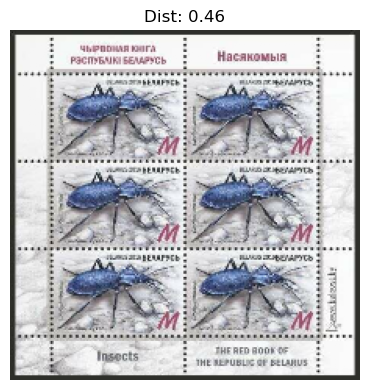


Class 3
Class 3 - Outliers removed: 0
No outliers detected for this class.

Class 4
Class 4 - Outliers removed: 0
No outliers detected for this class.

Class 5
Class 5 - Outliers removed: 19
Showing 19 outlier(s):


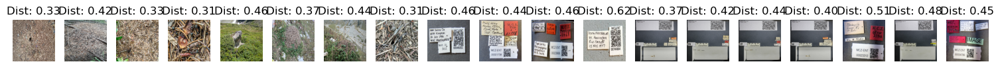


Class 6
Class 6 - Outliers removed: 0
No outliers detected for this class.

Class 7
Class 7 - Outliers removed: 0
No outliers detected for this class.

Class 8
Class 8 - Outliers removed: 0
No outliers detected for this class.

Class 9
Class 9 - Outliers removed: 0
No outliers detected for this class.

Class 10
Class 10 - Outliers removed: 0
No outliers detected for this class.

Class 11
Class 11 - Outliers removed: 0
No outliers detected for this class.

Class 12
Class 12 - Outliers removed: 0
No outliers detected for this class.

Class 13
Class 13 - Outliers removed: 0
No outliers detected for this class.

Class 14
Class 14 - Outliers removed: 0
No outliers detected for this class.

Class 15
Class 15 - Outliers removed: 0
No outliers detected for this class.

Class 16
Class 16 - Outliers removed: 0
No outliers detected for this class.

Class 17
Class 17 - Outliers removed: 1
Showing 1 outlier(s):


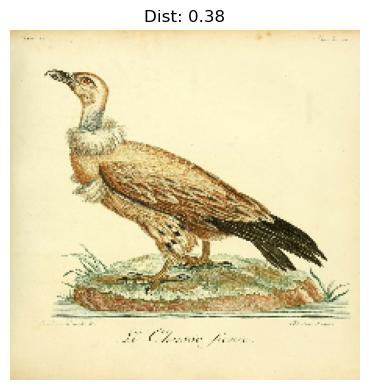


Class 18
Class 18 - Outliers removed: 6
Showing 6 outlier(s):


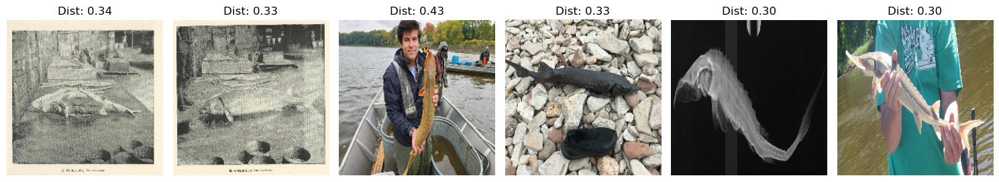


Class 19
Class 19 - Outliers removed: 0
No outliers detected for this class.

Class 20
Class 20 - Outliers removed: 1
Showing 1 outlier(s):


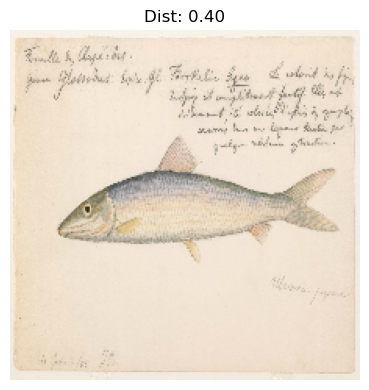


Class 21
Class 21 - Outliers removed: 2
Showing 2 outlier(s):


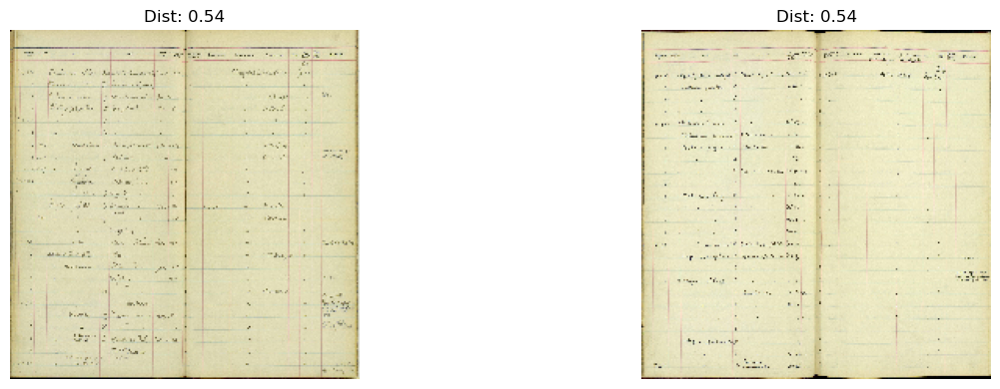


Class 22
Class 22 - Outliers removed: 0
No outliers detected for this class.

Class 23
Class 23 - Outliers removed: 0
No outliers detected for this class.

Class 24
Class 24 - Outliers removed: 0
No outliers detected for this class.

Class 25
Class 25 - Outliers removed: 21
Showing 21 outlier(s):


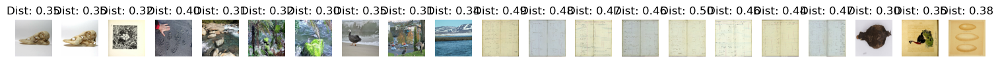


Class 26
Class 26 - Outliers removed: 0
No outliers detected for this class.

Class 27
Class 27 - Outliers removed: 0
No outliers detected for this class.

Class 28
Class 28 - Outliers removed: 0
No outliers detected for this class.

Class 29
Class 29 - Outliers removed: 2
Showing 2 outlier(s):


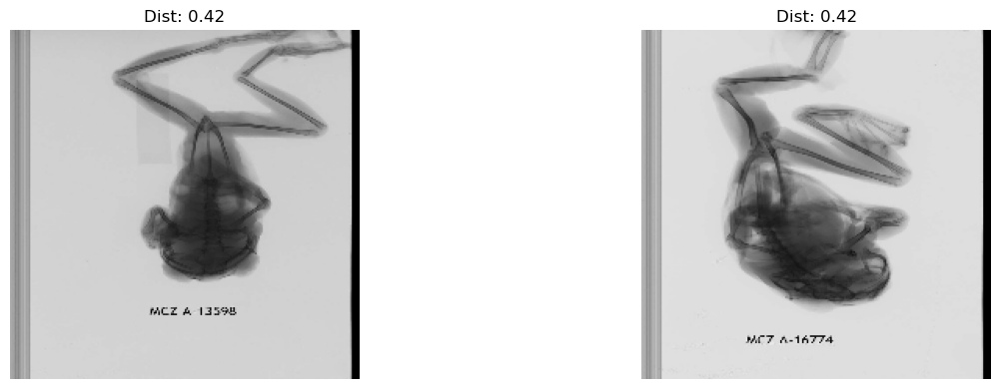


Class 30
Class 30 - Outliers removed: 5
Showing 5 outlier(s):


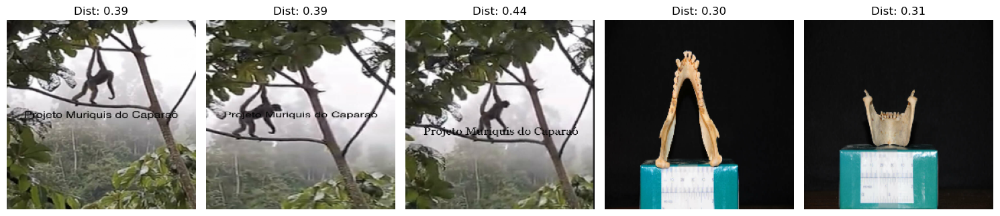


Class 31
Class 31 - Outliers removed: 0
No outliers detected for this class.

Class 32
Class 32 - Outliers removed: 0
No outliers detected for this class.

Class 33
Class 33 - Outliers removed: 0
No outliers detected for this class.

Class 34
Class 34 - Outliers removed: 1
Showing 1 outlier(s):


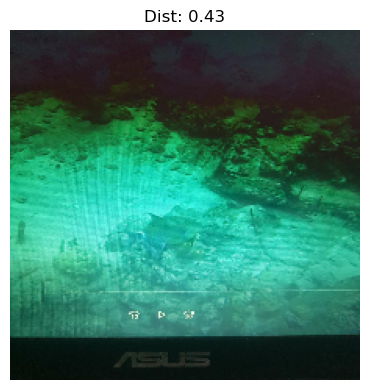


Class 35
Class 35 - Outliers removed: 0
No outliers detected for this class.

Class 36
Class 36 - Outliers removed: 17
Showing 17 outlier(s):


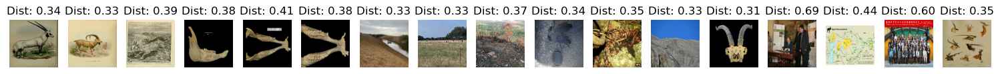


Class 37
Class 37 - Outliers removed: 0
No outliers detected for this class.

Class 38
Class 38 - Outliers removed: 12
Showing 12 outlier(s):


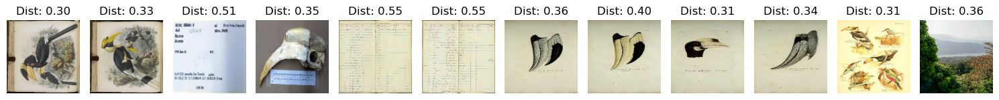


Class 39
Class 39 - Outliers removed: 0
No outliers detected for this class.

Class 40
Class 40 - Outliers removed: 0
No outliers detected for this class.

Class 41
Class 41 - Outliers removed: 1
Showing 1 outlier(s):


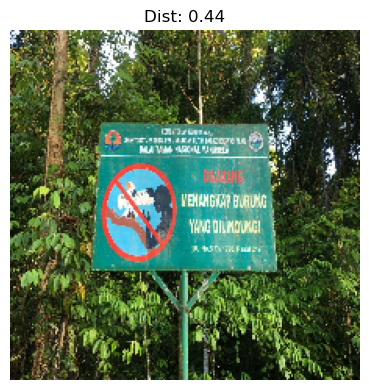


Class 42
Class 42 - Outliers removed: 1
Showing 1 outlier(s):


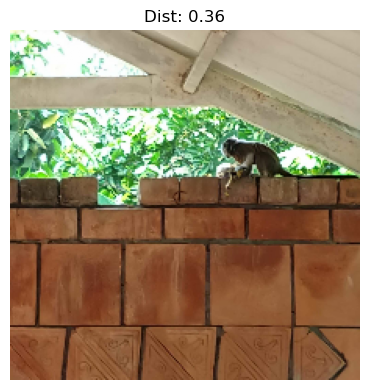


Class 43
Class 43 - Outliers removed: 1
Showing 1 outlier(s):


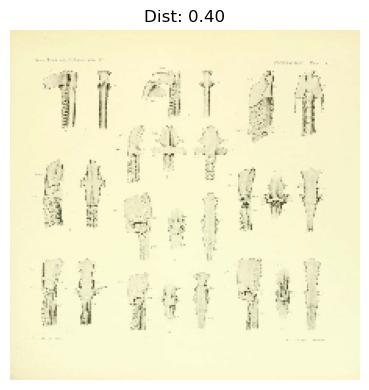


Class 44
Class 44 - Outliers removed: 1
Showing 1 outlier(s):


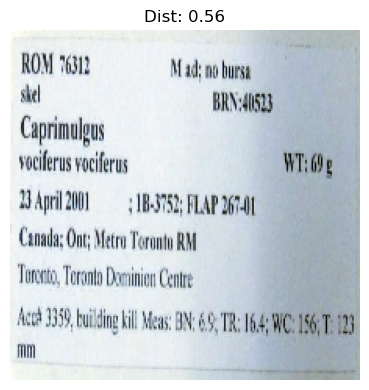


Class 45
Class 45 - Outliers removed: 10
Showing 10 outlier(s):


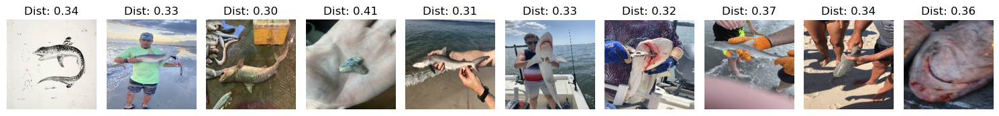


Class 46
Class 46 - Outliers removed: 0
No outliers detected for this class.

Class 47
Class 47 - Outliers removed: 6
Showing 6 outlier(s):


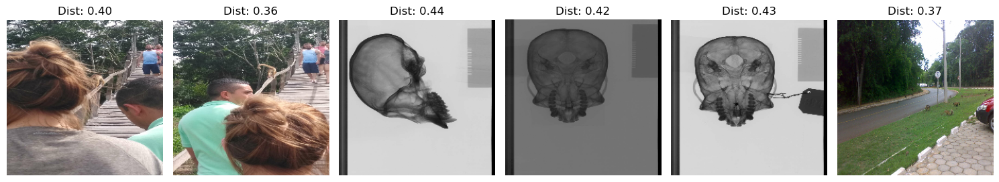


Class 48
Class 48 - Outliers removed: 25
Showing 25 outlier(s):


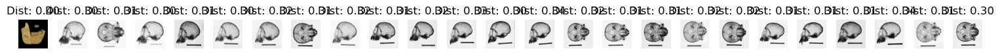


Class 49
Class 49 - Outliers removed: 0
No outliers detected for this class.

Class 50
Class 50 - Outliers removed: 0
No outliers detected for this class.

Class 51
Class 51 - Outliers removed: 0
No outliers detected for this class.

Class 52
Class 52 - Outliers removed: 0
No outliers detected for this class.

Class 53
Class 53 - Outliers removed: 0
No outliers detected for this class.

Class 54
Class 54 - Outliers removed: 0
No outliers detected for this class.

Class 55
Class 55 - Outliers removed: 0
No outliers detected for this class.

Class 56
Class 56 - Outliers removed: 0
No outliers detected for this class.

Class 57
Class 57 - Outliers removed: 2
Showing 2 outlier(s):


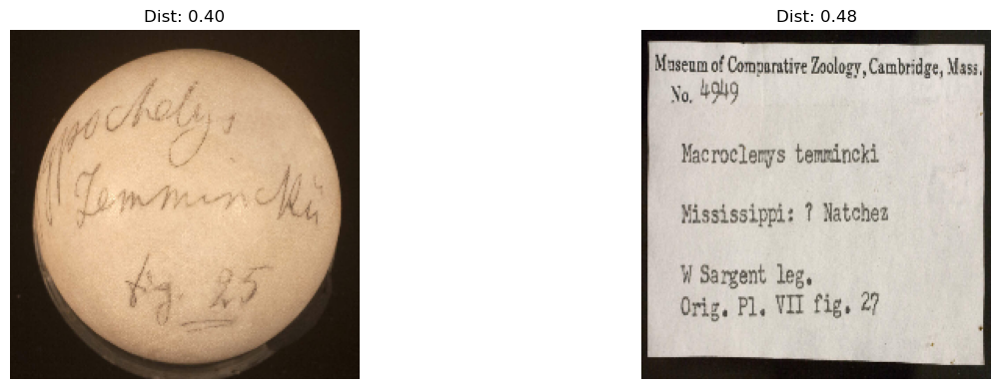


Class 58
Class 58 - Outliers removed: 3
Showing 3 outlier(s):


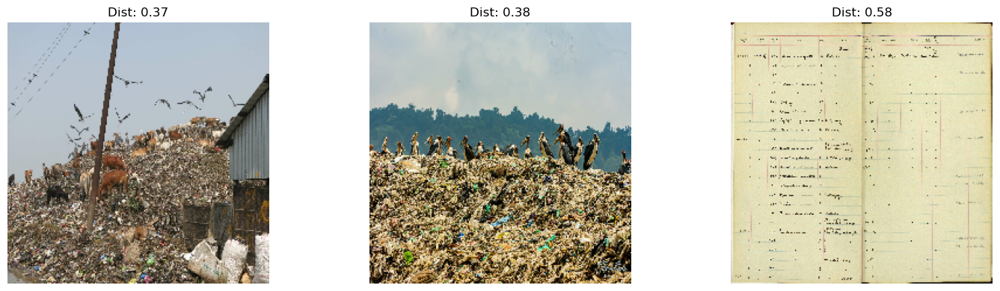


Class 59
Class 59 - Outliers removed: 3
Showing 3 outlier(s):


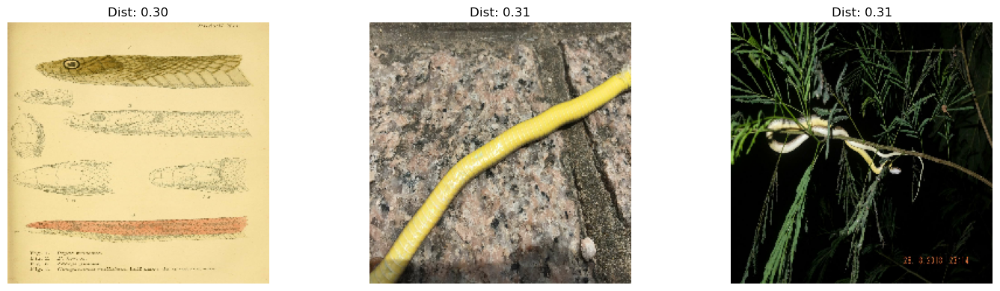


Class 60
Class 60 - Outliers removed: 0
No outliers detected for this class.

Class 61
Class 61 - Outliers removed: 0
No outliers detected for this class.

Class 62
Class 62 - Outliers removed: 0
No outliers detected for this class.

Class 63
Class 63 - Outliers removed: 0
No outliers detected for this class.

Class 64
Class 64 - Outliers removed: 0
No outliers detected for this class.

Class 65
Class 65 - Outliers removed: 0
No outliers detected for this class.

Class 66
Class 66 - Outliers removed: 0
No outliers detected for this class.

Class 67
Class 67 - Outliers removed: 1
Showing 1 outlier(s):


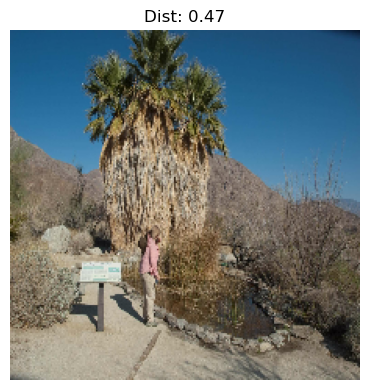


Class 68
Class 68 - Outliers removed: 15
Showing 15 outlier(s):


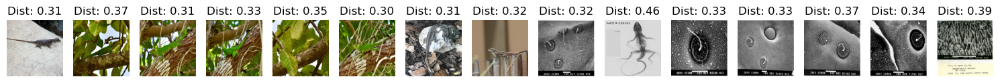


Class 69
Class 69 - Outliers removed: 0
No outliers detected for this class.

Class 70
Class 70 - Outliers removed: 9
Showing 9 outlier(s):


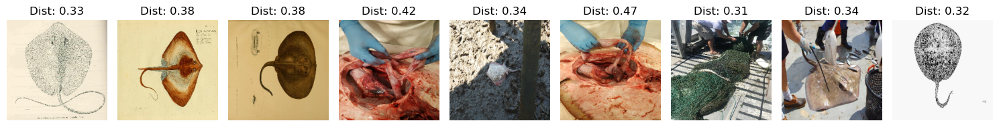


Class 71
Class 71 - Outliers removed: 0
No outliers detected for this class.

Class 72
Class 72 - Outliers removed: 0
No outliers detected for this class.

Class 73
Class 73 - Outliers removed: 0
No outliers detected for this class.

Class 74
Class 74 - Outliers removed: 5
Showing 5 outlier(s):


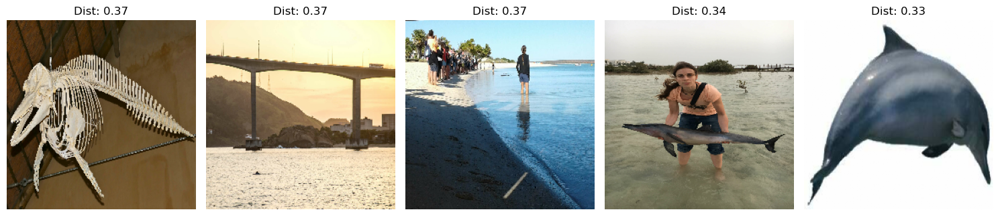


Class 75
Class 75 - Outliers removed: 0
No outliers detected for this class.

Class 76
Class 76 - Outliers removed: 12
Showing 12 outlier(s):


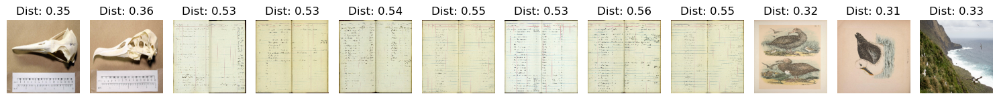


Class 77
Class 77 - Outliers removed: 0
No outliers detected for this class.

Class 78
Class 78 - Outliers removed: 1
Showing 1 outlier(s):


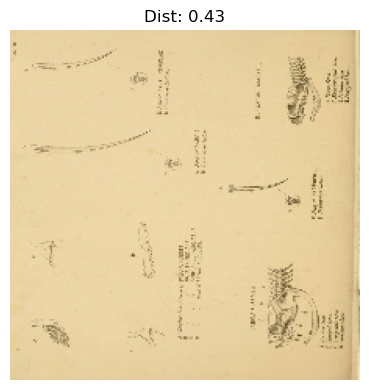


Class 79
Class 79 - Outliers removed: 1
Showing 1 outlier(s):


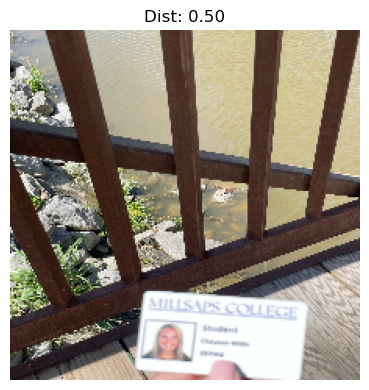


Class 80
Class 80 - Outliers removed: 0
No outliers detected for this class.

Class 81
Class 81 - Outliers removed: 0
No outliers detected for this class.

Class 82
Class 82 - Outliers removed: 1
Showing 1 outlier(s):


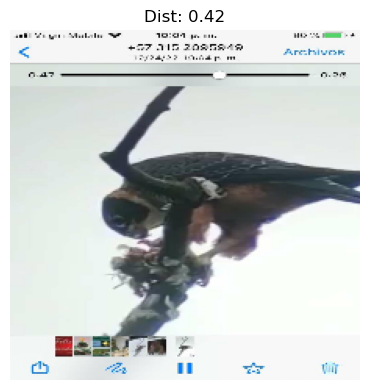


Class 83
Class 83 - Outliers removed: 0
No outliers detected for this class.

Class 84
Class 84 - Outliers removed: 0
No outliers detected for this class.

Class 85
Class 85 - Outliers removed: 0
No outliers detected for this class.

Class 86
Class 86 - Outliers removed: 0
No outliers detected for this class.

Class 87
Class 87 - Outliers removed: 1
Showing 1 outlier(s):


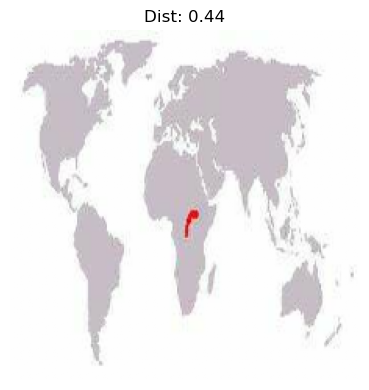


Class 88
Class 88 - Outliers removed: 0
No outliers detected for this class.

Class 89
Class 89 - Outliers removed: 0
No outliers detected for this class.

Class 90
Class 90 - Outliers removed: 0
No outliers detected for this class.

Class 91
Class 91 - Outliers removed: 0
No outliers detected for this class.

Class 92
Class 92 - Outliers removed: 0
No outliers detected for this class.

Class 93
Class 93 - Outliers removed: 1
Showing 1 outlier(s):


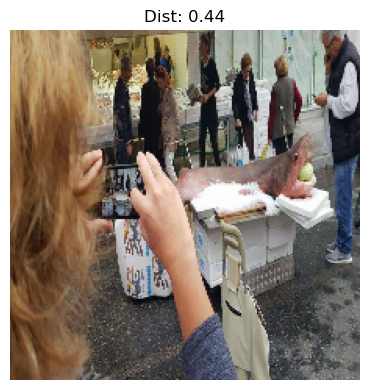


Class 94
Class 94 - Outliers removed: 0
No outliers detected for this class.

Class 95
Class 95 - Outliers removed: 0
No outliers detected for this class.

Class 96
Class 96 - Outliers removed: 0
No outliers detected for this class.

Class 97
Class 97 - Outliers removed: 0
No outliers detected for this class.

Class 98
Class 98 - Outliers removed: 7
Showing 7 outlier(s):


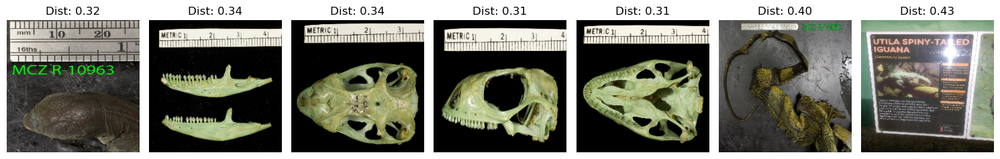


Class 99
Class 99 - Outliers removed: 0
No outliers detected for this class.

Class 100
Class 100 - Outliers removed: 0
No outliers detected for this class.

Class 101
Class 101 - Outliers removed: 0
No outliers detected for this class.

Class 102
Class 102 - Outliers removed: 0
No outliers detected for this class.

Class 103
Class 103 - Outliers removed: 10
Showing 10 outlier(s):


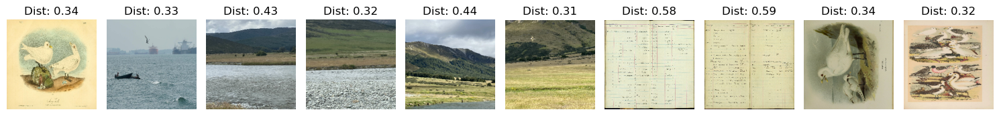


Class 104
Class 104 - Outliers removed: 0
No outliers detected for this class.

Class 105
Class 105 - Outliers removed: 1
Showing 1 outlier(s):


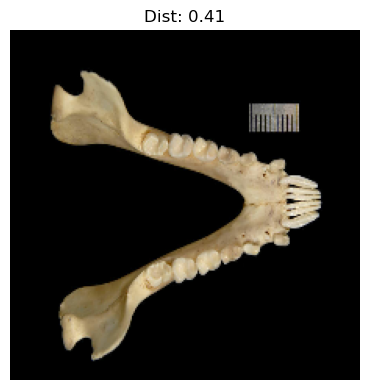


Class 106
Class 106 - Outliers removed: 1
Showing 1 outlier(s):


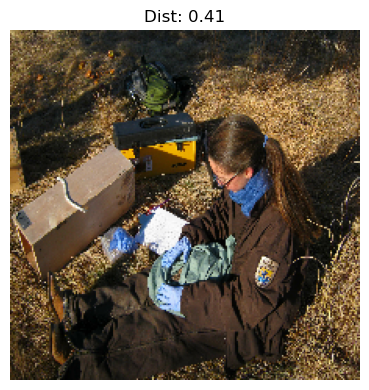


Class 107
Class 107 - Outliers removed: 1
Showing 1 outlier(s):


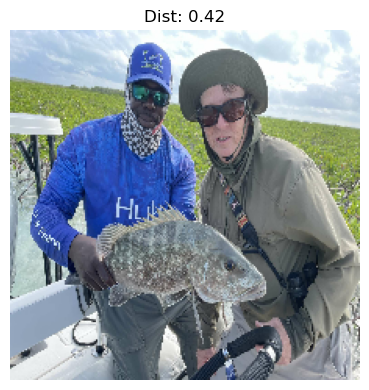


Class 108
Class 108 - Outliers removed: 0
No outliers detected for this class.

Class 109
Class 109 - Outliers removed: 1
Showing 1 outlier(s):


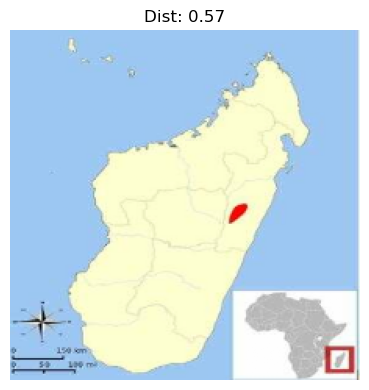


Class 110
Class 110 - Outliers removed: 1
Showing 1 outlier(s):


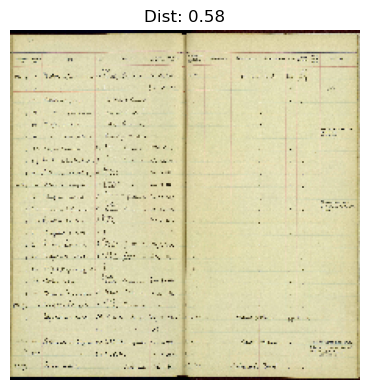


Class 111
Class 111 - Outliers removed: 0
No outliers detected for this class.

Class 112
Class 112 - Outliers removed: 0
No outliers detected for this class.

Class 113
Class 113 - Outliers removed: 0
No outliers detected for this class.

Class 114
Class 114 - Outliers removed: 0
No outliers detected for this class.

Class 115
Class 115 - Outliers removed: 1
Showing 1 outlier(s):


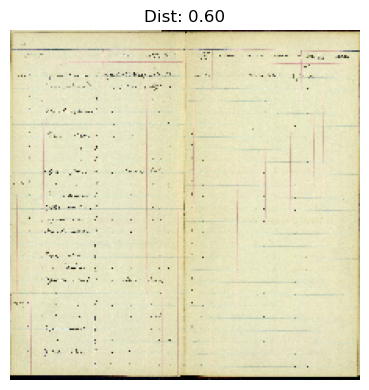


Class 116
Class 116 - Outliers removed: 2
Showing 2 outlier(s):


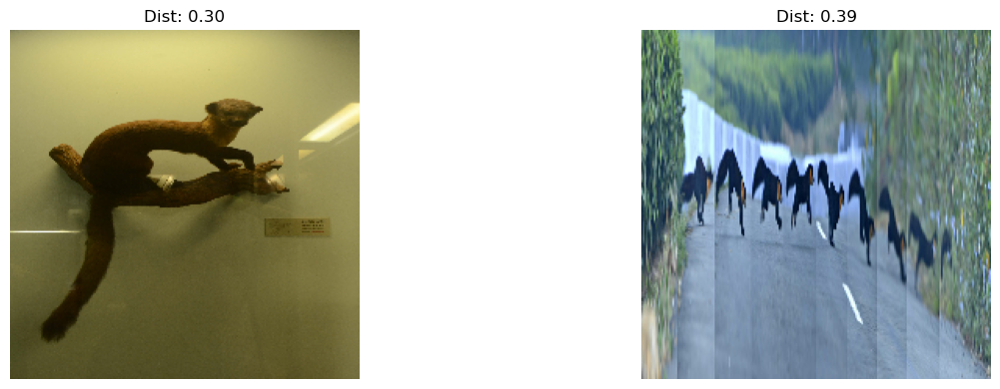


Class 117
Class 117 - Outliers removed: 2
Showing 2 outlier(s):


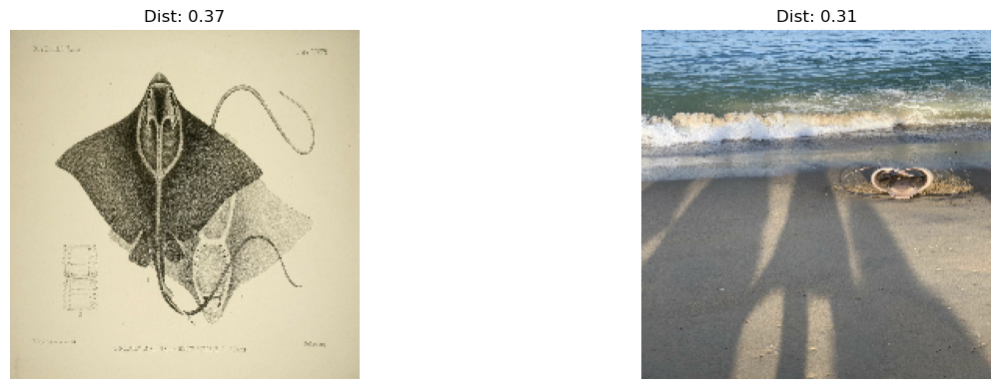


Class 118
Class 118 - Outliers removed: 0
No outliers detected for this class.

Class 119
Class 119 - Outliers removed: 0
No outliers detected for this class.

Class 120
Class 120 - Outliers removed: 0
No outliers detected for this class.

Class 121
Class 121 - Outliers removed: 0
No outliers detected for this class.

Class 122
Class 122 - Outliers removed: 0
No outliers detected for this class.

Class 123
Class 123 - Outliers removed: 1
Showing 1 outlier(s):


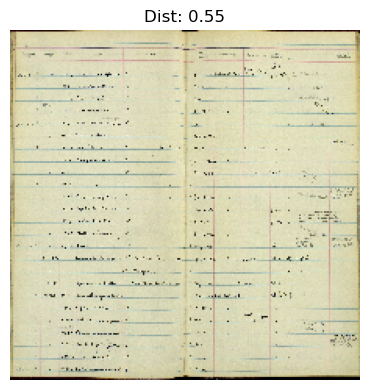


Class 124
Class 124 - Outliers removed: 0
No outliers detected for this class.

Class 125
Class 125 - Outliers removed: 0
No outliers detected for this class.

Class 126
Class 126 - Outliers removed: 0
No outliers detected for this class.

Class 127
Class 127 - Outliers removed: 0
No outliers detected for this class.

Class 128
Class 128 - Outliers removed: 0
No outliers detected for this class.

Class 129
Class 129 - Outliers removed: 0
No outliers detected for this class.

Class 130
Class 130 - Outliers removed: 0
No outliers detected for this class.

Class 131
Class 131 - Outliers removed: 0
No outliers detected for this class.

Class 132
Class 132 - Outliers removed: 12
Showing 12 outlier(s):


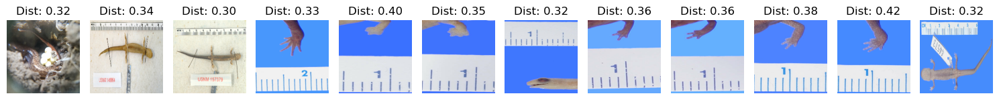


Class 133
Class 133 - Outliers removed: 0
No outliers detected for this class.

Class 134
Class 134 - Outliers removed: 0
No outliers detected for this class.

Class 135
Class 135 - Outliers removed: 0
No outliers detected for this class.

Class 136
Class 136 - Outliers removed: 1
Showing 1 outlier(s):


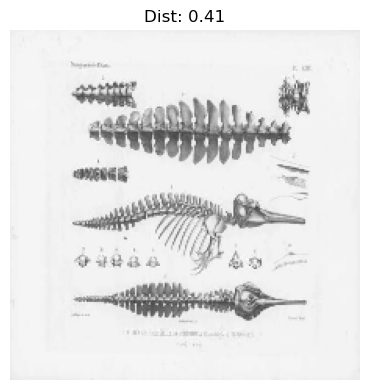


Class 137
Class 137 - Outliers removed: 0
No outliers detected for this class.

Class 138
Class 138 - Outliers removed: 0
No outliers detected for this class.

Class 139
Class 139 - Outliers removed: 10
Showing 10 outlier(s):


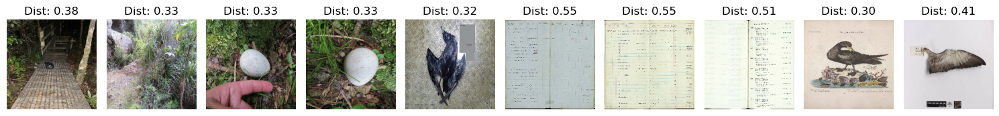


Class 140
Class 140 - Outliers removed: 2
Showing 2 outlier(s):


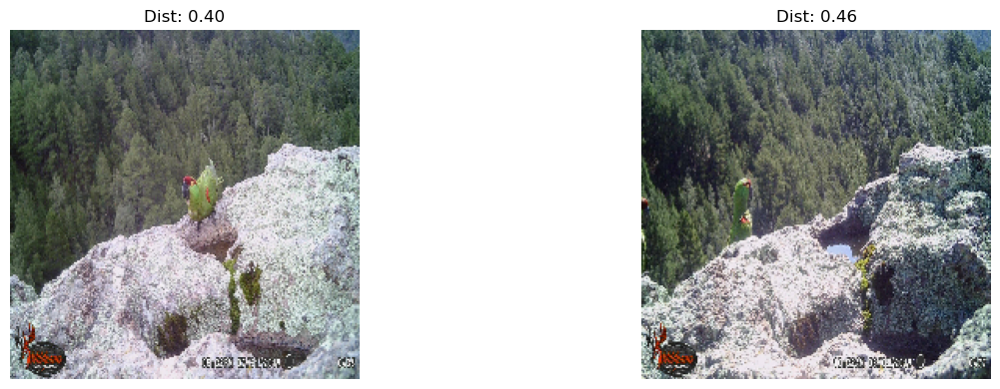


Class 141
Class 141 - Outliers removed: 0
No outliers detected for this class.

Class 142
Class 142 - Outliers removed: 1
Showing 1 outlier(s):


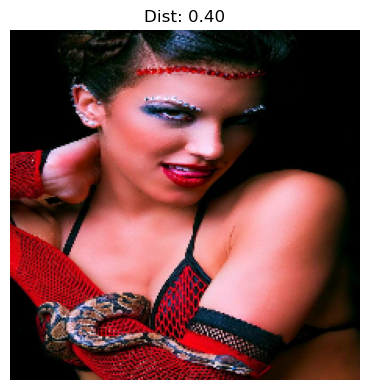


Class 143
Class 143 - Outliers removed: 2
Showing 2 outlier(s):


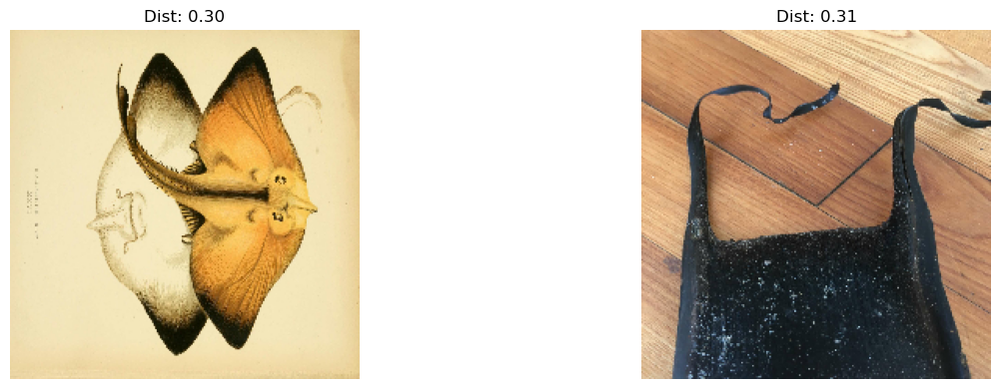


Class 144
Class 144 - Outliers removed: 0
No outliers detected for this class.

Class 145
Class 145 - Outliers removed: 1
Showing 1 outlier(s):


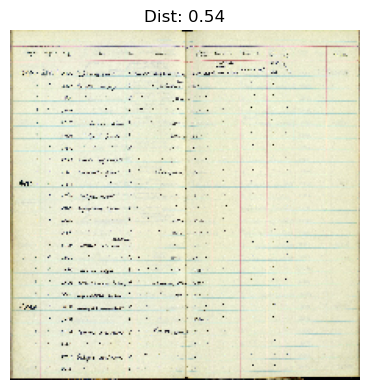


Class 146
Class 146 - Outliers removed: 1
Showing 1 outlier(s):


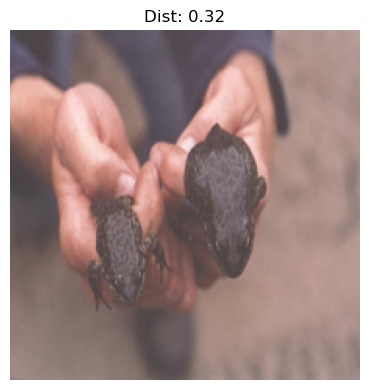


Class 147
Class 147 - Outliers removed: 0
No outliers detected for this class.

Class 148
Class 148 - Outliers removed: 0
No outliers detected for this class.

Class 149
Class 149 - Outliers removed: 0
No outliers detected for this class.

Class 150
Class 150 - Outliers removed: 1
Showing 1 outlier(s):


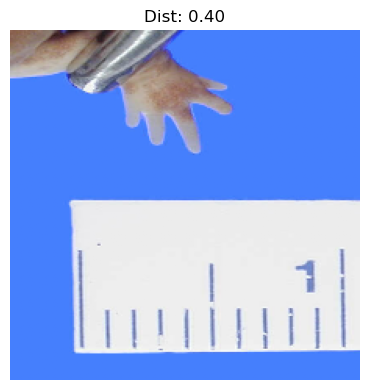


Class 151
Class 151 - Outliers removed: 6
Showing 6 outlier(s):


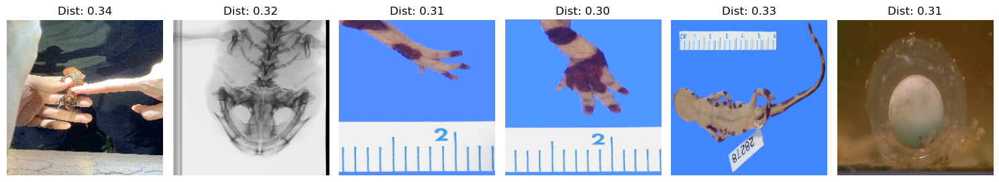


Class 152
Class 152 - Outliers removed: 1
Showing 1 outlier(s):


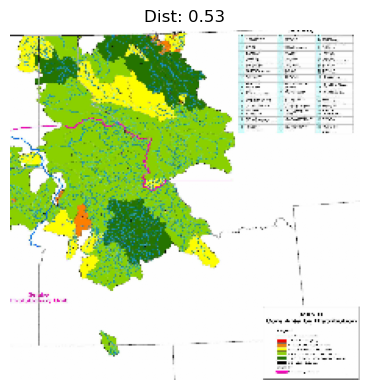


Class 153
Class 153 - Outliers removed: 0
No outliers detected for this class.

Class 154
Class 154 - Outliers removed: 0
No outliers detected for this class.

Class 155
Class 155 - Outliers removed: 4
Showing 4 outlier(s):


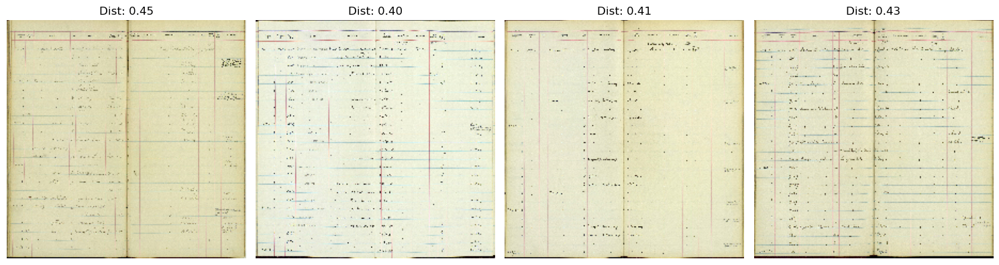


Class 156
Class 156 - Outliers removed: 0
No outliers detected for this class.

Class 157
Class 157 - Outliers removed: 4
Showing 4 outlier(s):


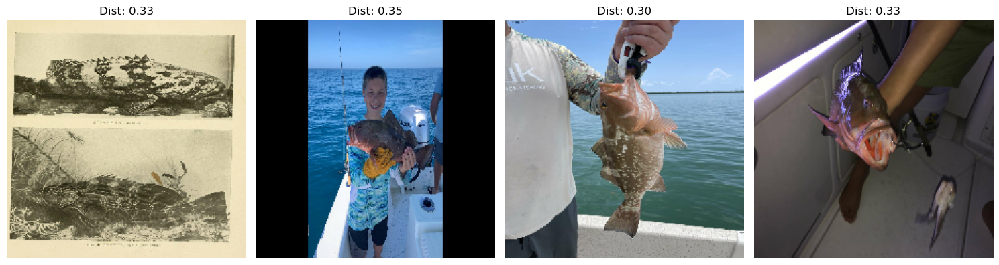


Class 158
Class 158 - Outliers removed: 0
No outliers detected for this class.

Class 159
Class 159 - Outliers removed: 0
No outliers detected for this class.

Class 160
Class 160 - Outliers removed: 0
No outliers detected for this class.

Class 161
Class 161 - Outliers removed: 0
No outliers detected for this class.

Class 162
Class 162 - Outliers removed: 7
Showing 7 outlier(s):


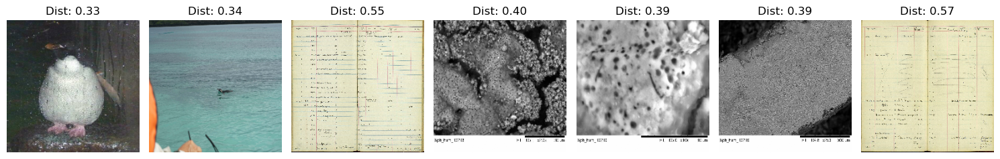


Class 163
Class 163 - Outliers removed: 7
Showing 7 outlier(s):


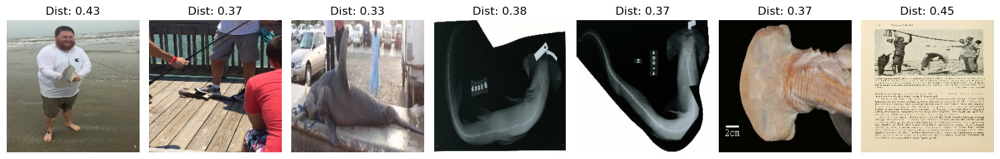


Class 164
Class 164 - Outliers removed: 0
No outliers detected for this class.

Class 165
Class 165 - Outliers removed: 1
Showing 1 outlier(s):


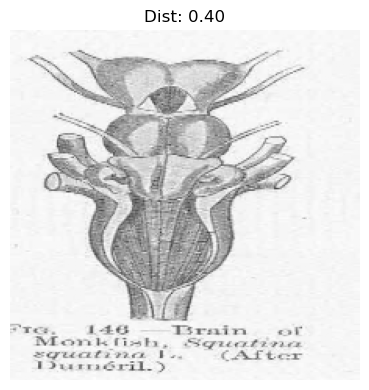


Class 166
Class 166 - Outliers removed: 0
No outliers detected for this class.

Class 167
Class 167 - Outliers removed: 2
Showing 2 outlier(s):


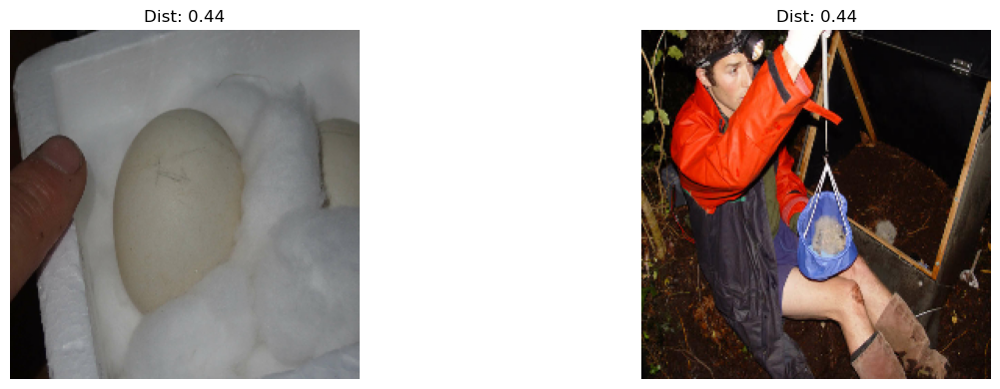


Class 168
Class 168 - Outliers removed: 0
No outliers detected for this class.

Class 169
Class 169 - Outliers removed: 1
Showing 1 outlier(s):


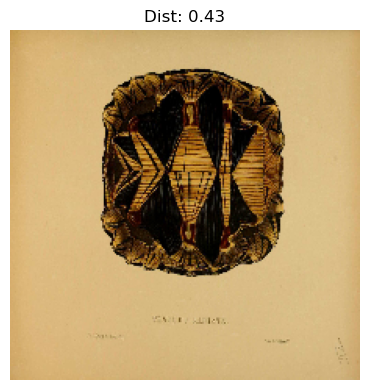


Class 170
Class 170 - Outliers removed: 2
Showing 2 outlier(s):


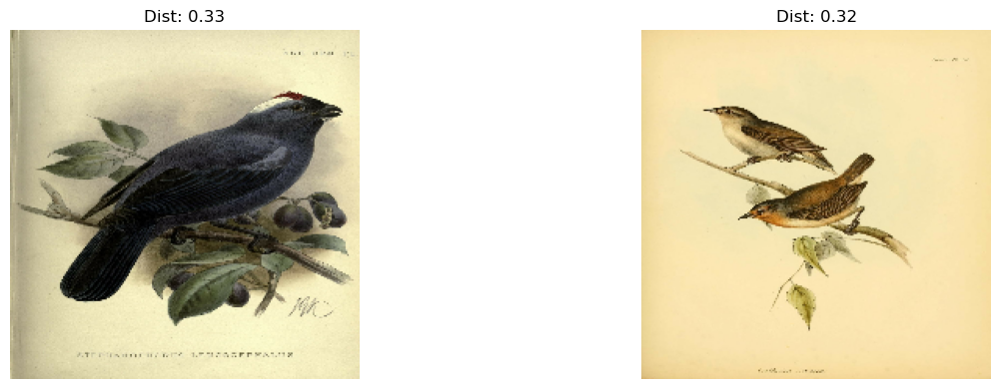


Class 171
Class 171 - Outliers removed: 0
No outliers detected for this class.

Class 172
Class 172 - Outliers removed: 2
Showing 2 outlier(s):


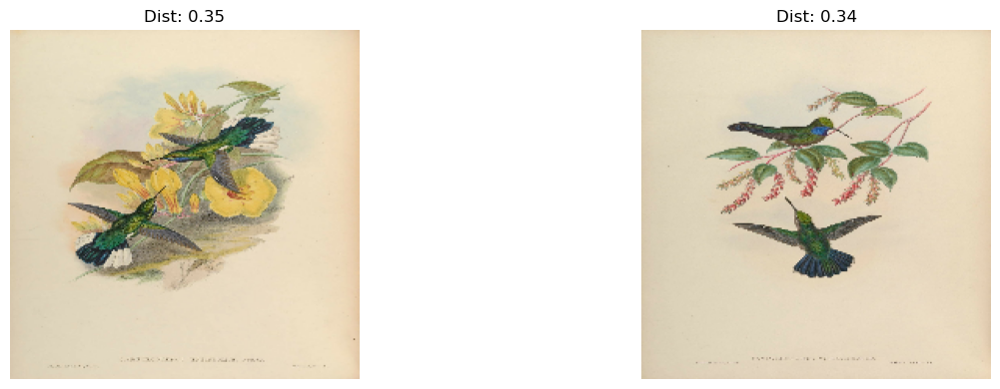


Class 173
Class 173 - Outliers removed: 0
No outliers detected for this class.

Class 174
Class 174 - Outliers removed: 0
No outliers detected for this class.

Class 175
Class 175 - Outliers removed: 0
No outliers detected for this class.

Class 176
Class 176 - Outliers removed: 0
No outliers detected for this class.

Class 177
Class 177 - Outliers removed: 2
Showing 2 outlier(s):


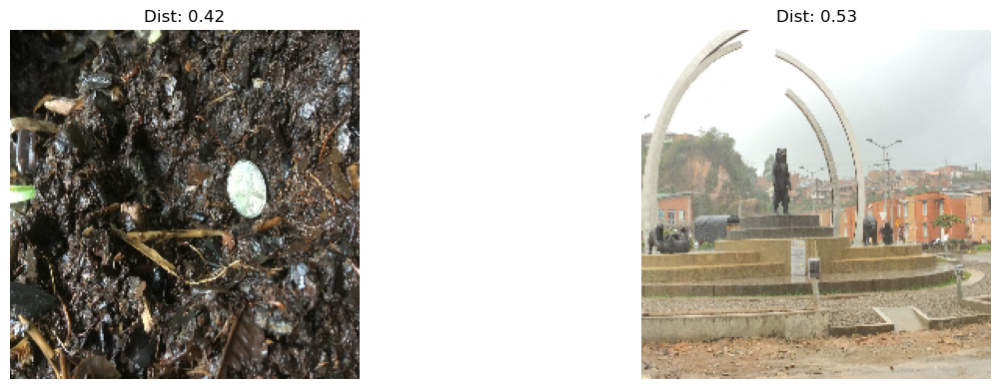


Class 178
Class 178 - Outliers removed: 1
Showing 1 outlier(s):


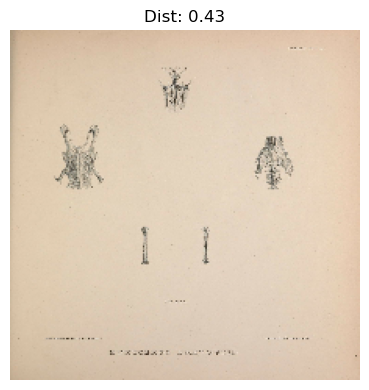


Class 179
Class 179 - Outliers removed: 0
No outliers detected for this class.

Class 180
Class 180 - Outliers removed: 0
No outliers detected for this class.

Class 181
Class 181 - Outliers removed: 0
No outliers detected for this class.

Class 182
Class 182 - Outliers removed: 0
No outliers detected for this class.

Class 183
Class 183 - Outliers removed: 2
Showing 2 outlier(s):


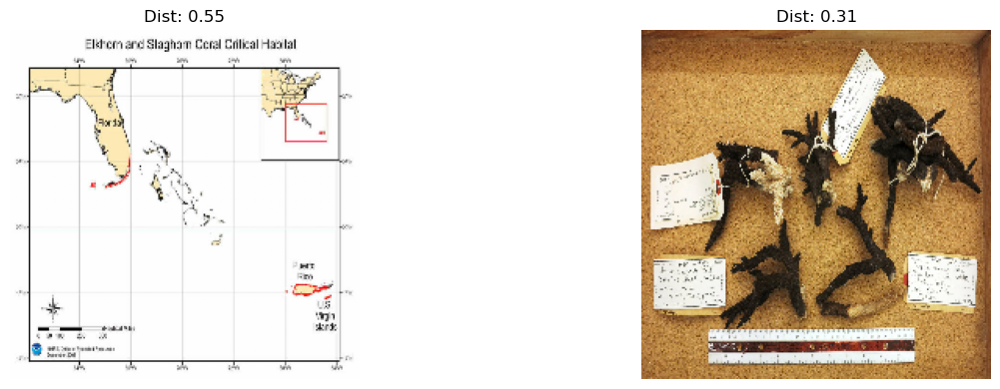


Class 184
Class 184 - Outliers removed: 1
Showing 1 outlier(s):


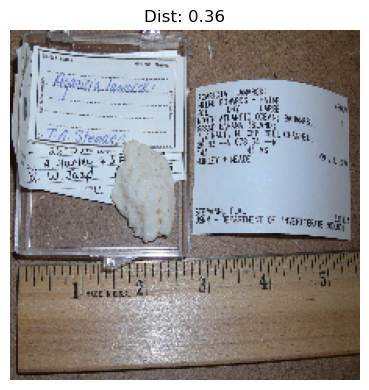


Class 185
Class 185 - Outliers removed: 0
No outliers detected for this class.

Class 186
Class 186 - Outliers removed: 0
No outliers detected for this class.

Class 187
Class 187 - Outliers removed: 0
No outliers detected for this class.

Class 188
Class 188 - Outliers removed: 0
No outliers detected for this class.

Class 189
Class 189 - Outliers removed: 0
No outliers detected for this class.

Class 190
Class 190 - Outliers removed: 0
No outliers detected for this class.

Class 191
Class 191 - Outliers removed: 1
Showing 1 outlier(s):


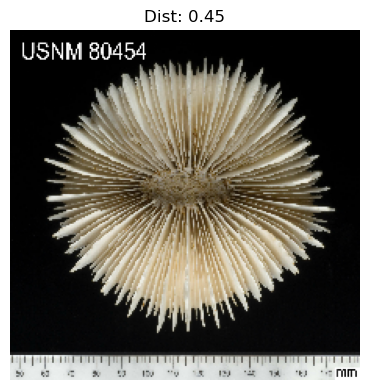


Class 192
Class 192 - Outliers removed: 0
No outliers detected for this class.

Class 193
Class 193 - Outliers removed: 0
No outliers detected for this class.

Class 194
Class 194 - Outliers removed: 0
No outliers detected for this class.

Class 195
Class 195 - Outliers removed: 0
No outliers detected for this class.

Class 196
Class 196 - Outliers removed: 0
No outliers detected for this class.

Class 197
Class 197 - Outliers removed: 0
No outliers detected for this class.

Class 198
Class 198 - Outliers removed: 0
No outliers detected for this class.

Class 199
Class 199 - Outliers removed: 0
No outliers detected for this class.

Class 200
Class 200 - Outliers removed: 0
No outliers detected for this class.

Class 201
Class 201 - Outliers removed: 0
No outliers detected for this class.

Total outliers identified: 293
Total images after outlier removal: 6895
Cleaned dataset contains 6895 images.


In [24]:
clip_model = TFCLIPModel.from_pretrained("openai/clip-vit-base-patch32")
clip_processor = CLIPProcessor.from_pretrained("openai/clip-vit-base-patch32")

def extract_clip_embeddings(image_paths, target_size=(224, 224)):
    images = []
    for path in image_paths:
        image = tf.io.read_file(path)
        image = tf.image.decode_jpeg(image, channels=3)
        image = tf.image.resize(image, target_size)
        image = tf.cast(image, tf.uint8).numpy()
        images.append(image)
    
    inputs = clip_processor(images=images, return_tensors="tf", padding=True)
    outputs = clip_model.get_image_features(**inputs)
    return outputs.numpy()

def show_outlier_candidates(image_paths, distances, outlier_mask):
    outlier_indices = np.where(outlier_mask)[0]
    num_to_show = len(outlier_indices)
    if num_to_show == 0:
        print("No outliers detected for this class.\n")
        return
    print(f"Showing {num_to_show} outlier(s):")
    plt.figure(figsize=(15, 4))
    for i, idx in enumerate(outlier_indices):
        img = tf.io.read_file(image_paths[idx])
        img = tf.image.decode_jpeg(img, channels=3)
        img = tf.image.resize(img, (224, 224)) / 255.0
        plt.subplot(1, num_to_show, i+1)
        plt.imshow(img)
        plt.title(f"Dist: {distances[idx]:.2f}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()
    print("")

def remove_outliers_clip(image_paths, labels, k_std=2.5):
    
    image_paths = np.array(image_paths)
    cleaned_image_paths = []
    cleaned_image_labels = []
    total_outliers = 0

    unique_labels = np.unique(labels)

    for label in unique_labels:
        print(f"Class {label}")
        class_indices = np.where(labels == label)[0]
        class_image_paths = image_paths[class_indices]
        class_size = len(class_image_paths)


        # if len(class_image_paths) < 30: 
        #     print("Not enough images to evaluate.\n")

        #     cleaned_image_paths.extend(class_image_paths)
        #     cleaned_image_labels.extend([label] * len(class_image_paths))
        #     continue

        embeddings = extract_clip_embeddings(class_image_paths)
        centroid = np.mean(embeddings, axis=0, keepdims=True)
        distances = cosine_distances(embeddings, centroid).flatten()

        #mean = np.mean(distances)
        #std = np.std(distances)
        #threshold = mean + k_std * std
        threshold = 0.3 if class_size > 50 else 0.4


        outlier_mask = distances >= threshold
        non_outlier_indices = np.where(outlier_mask == False)[0]
        outlier_indices = np.where(outlier_mask)[0]
        total_outliers += len(outlier_indices)

        print(f"Class {label} - Outliers removed: {len(outlier_indices)}")

        show_outlier_candidates(class_image_paths, distances, outlier_mask)

        cleaned_image_paths.extend(np.array(class_image_paths)[non_outlier_indices])
        cleaned_image_labels.extend([label] * len(non_outlier_indices))

    print(f"Total outliers identified: {total_outliers}")
    print(f"Total images after outlier removal: {len(cleaned_image_paths)}")

    return np.array(cleaned_image_paths), np.array(cleaned_image_labels)


cleaned_image_paths, cleaned_image_labels = remove_outliers_clip(train_paths, train_labels, 2)

print(f"Cleaned dataset contains {len(cleaned_image_paths)} images.")

In [25]:
shutil.rmtree("data_clean_clip", ignore_errors=True)

save_clean_images(cleaned_image_paths, cleaned_image_labels, target_root="data_clean_clip")

train_df_cleaned = get_image_paths_and_labels(Path('.')/'data_clean_clip')


Saved 6895 cleaned images to: data_clean_clip


### **Compare the 3 Outlier Approaches**

We will use a simple sequential model to compare the 3 approaches and decide which one to adopt moving forward.

In [26]:
# input_shape = (224, 224, 3)
# n_classes = 202


# categorical_accuracy = CategoricalAccuracy(name="accuracy")
# precision = CategoricalAccuracy(name="precision")
# recall = CategoricalAccuracy(name="recall")
# f1_score = F1Score(average="macro", name="f1_score")
# metrics = [categorical_accuracy,precision, recall, f1_score]

In [27]:
# model = Sequential(
#     layers=[
#         Input(shape=input_shape),
#         Conv2D(filters=24, kernel_size=(3, 3), activation="relu"),  
#         MaxPooling2D(pool_size=(2, 2)),
#         Conv2D(filters=48, kernel_size=(3, 3), activation="relu"),
#         MaxPooling2D(pool_size=(2, 2)),
#         Flatten(),
#         Dense(n_classes, activation="softmax"),
#     ],
#     name="sequential")

# model.compile(
#     optimizer="adam",
#     loss="categorical_crossentropy",
#     metrics=metrics)

In [28]:
# def compare_outliers(model, train_df):
#         history = model.fit(
#         train_dataset,
#         validation_data=val_dataset,
#         epochs=10)

#     results = model.evaluate(
#         test_dataset,
#         return_dict=True,
#         verbose=0)

#     return results

In [29]:
# dest_root = Path('.') 
# data_clean_dbscan = get_image_paths_and_labels(dest_root / 'data_clean_dbscan')
# data_clean_vgg16 = get_image_paths_and_labels(dest_root / 'data_clean_vgg16')
# data_clean_clip = get_image_paths_and_labels(dest_root / 'data_clean_clip')

# methods = {
#     "With all imagens": train_dataset,
#     "DBSCAN": data_clean_dbscan,
#     "VGG16": data_clean_vgg16,
#     "CLIP": data_clean_clip}

# results = []

# for method_name, dataset in methods.items():
#     metrics = compare_outliers(model, dataset)
#     metrics["method"] = method_name
#     results.append(metrics)

In [30]:
# df_results = pd.DataFrame(results)
# df_results = df_results[["method"] + [col for col in df_results.columns if col != "method"]]
# df_results

The outlier detection approach based on CLIP has the best results. Therefore, we will proceed using train_df = train_df_cleaned and we will only use this approach for the next notebook where we develop the model from scratch.

In [31]:
train_df = train_df_cleaned

<a class="anchor" id="four-bullet"> 
<d style="color:white;">

## 5. Oversampling 
</a> 
</d>
Using augmentation to the minority classes to oversample them to see if this will work well in our dataset and if representing better the smaller classes can indeed improve classification.
For this we create a new folder called 'data_aug_clip' as the data we are augmenting is the train dated cleaned after the removal of outliers with clip (best outlier method).

This approach was tried outside of the model because it is easier to control this, being more able to ensure that the minority classes are the ones being augmented and not the majority.

In [32]:
label_counts = Counter(train_labels)
max_count = max(label_counts.values())

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.1,
    height_shift_range=0.1,
    shear_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    brightness_range=[0.6, 1.4],  
    preprocessing_function=lambda x: tf.image.random_contrast(x, lower=0.6, upper=1.4)
)

augmented_root = Path("data_aug_clip")
shutil.rmtree(augmented_root, ignore_errors=True)

for label in np.unique(train_labels):
    class_indices = np.where(train_labels == label)[0]
    class_paths = train_paths[class_indices]
    n_current = len(class_paths)
    n_to_add = max_count - n_current

    class_dir = augmented_root / str(label)
    class_dir.mkdir(parents=True, exist_ok=True)

    for path in class_paths:
        shutil.copy(path, class_dir / Path(path).name)

    if n_to_add <= 0:
        continue

    print(f"Augmenting class {label} with {n_to_add} new images")

    images = []
    for path in class_paths:
        img = Image.open(path).convert('RGB').resize((224, 224))
        img = np.array(img)
        images.append(img)

    images = np.array(images)

    batch_size = 16
    augmented = datagen.flow(images, batch_size=batch_size, shuffle=False)

    saved = 0
    while saved < n_to_add:
        batch = next(augmented)
        for i in range(batch.shape[0]):
            if saved >= n_to_add:
                break
            img = Image.fromarray(batch[i].astype(np.uint8))
            filename = f"aug_{uuid.uuid4().hex}.jpg"
            img.save(class_dir / filename)
            saved += 1


Augmenting class 0 with 90 new images
Augmenting class 1 with 162 new images
Augmenting class 2 with 144 new images
Augmenting class 3 with 162 new images
Augmenting class 4 with 162 new images
Augmenting class 5 with 6 new images
Augmenting class 6 with 144 new images
Augmenting class 7 with 162 new images
Augmenting class 8 with 162 new images
Augmenting class 9 with 162 new images
Augmenting class 10 with 162 new images
Augmenting class 11 with 162 new images
Augmenting class 12 with 162 new images
Augmenting class 13 with 162 new images
Augmenting class 14 with 162 new images
Augmenting class 15 with 162 new images
Augmenting class 16 with 162 new images
Augmenting class 17 with 109 new images
Augmenting class 18 with 126 new images
Augmenting class 19 with 144 new images
Augmenting class 20 with 162 new images
Augmenting class 21 with 162 new images
Augmenting class 22 with 162 new images
Augmenting class 23 with 144 new images
Augmenting class 24 with 144 new images
Augmenting cl

KeyboardInterrupt: 